# EDA Geospatial Data — MINIMAL FIX (Choropleth Booking Density)
Notebook ini versi **minimal & stabil**:
- Tanpa widgets / filter rumit
- Satu layer choropleth saja (merah=tinggi, hijau=rendah)
- Opsional normalisasi per km² lewat satu flag
- Auto-load Supabase **jika env tersedia**, jika tidak pakai CSV fallback


In [1]:
# ==== Imports (minimal & stable) ====
import os
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely import wkt
import folium
from folium.features import GeoJson, GeoJsonTooltip
from branca.colormap import LinearColormap
from shapely import wkb

# Optional: Supabase via SQLAlchemy if env present
from dotenv import load_dotenv
from sqlalchemy import create_engine
load_dotenv()


True

In [2]:
# ==== Load data ====
# Try Supabase query if SUPABASE_DB_URL is available, else fallback to CSVs uploaded earlier
SUPABASE_DB_URL = os.getenv("SUPABASE_DB_URL")
use_supabase = bool(SUPABASE_DB_URL)

if use_supabase:
    engine = create_engine(SUPABASE_DB_URL)
    with engine.connect() as conn:
        # Trips with admin join (same as your previous query)
        df_avg_trip = pd.read_sql("""WITH completed_trips AS (
  SELECT
        t.trip_id,
        t.pickup_datetime,
        t.dropoff_datetime,
        t.pickup_latitude,
        t.pickup_longitude,
        t.dropoff_latitude,
        t.dropoff_longitude,
        t.distance_km,
        t.duration_minutes,
        t.vehicle_type,
        t.fare_amount,
        t.surge_multiplier,
        pup."NAME_4" AS pickup_admin,
        dof."NAME_4" AS dropoff_admin,
        p.geohash_list AS pickup_geohash,
        d.geohash_list AS dropoff_geohash
    FROM jakarta_ride_trips AS t
    LEFT JOIN id_adm_4 AS pup
        ON ST_Contains(pup.geometry, ST_SetSRID(ST_Point(t.pickup_longitude, t.pickup_latitude), 4326))
    LEFT JOIN id_adm_4 AS dof
        ON ST_Contains(dof.geometry, ST_SetSRID(ST_Point(t.dropoff_longitude, t.dropoff_latitude), 4326))
    LEFT JOIN id_jkt_geohash7 AS p
        ON ST_Intersects(p.geometry, ST_SetSRID(ST_Point(t.pickup_longitude, t.pickup_latitude), 4326))
    LEFT JOIN id_jkt_geohash7 AS d
        ON ST_Intersects(d.geometry, ST_SetSRID(ST_Point(t.dropoff_longitude, t.dropoff_latitude), 4326))
)
SELECT * FROM completed_trips""", conn)

        # Admin boundaries (Kelurahan, Jakarta Raya only)
        df_admin_jkt = pd.read_sql("""
SELECT 
  "NAME_1", "NAME_2", "NAME_3", "NAME_4",
  ST_AsText(geometry) AS wkt_geom
FROM id_adm_4
WHERE "NAME_1" in ('Jakarta Raya')""", conn)
else:
    # Fallback to uploaded CSVs
    df_avg_trip = pd.read_csv('/mnt/data/Supabase Snippet Jakarta Ride Trip Geolocation Mapping.csv')
    df_admin_jkt = pd.read_csv('/mnt/data/Supabase Snippet Jakarta Administrative Areas.csv')  # alt boundaries
    # If a richer boundaries file exists, prefer it
    if os.path.exists('/mnt/data/Supabase Snippet Jakarta Raya Administrative Boundaries.csv'):
        df_admin_jkt = pd.read_csv('/mnt/data/Supabase Snippet Jakarta Raya Administrative Boundaries.csv')

# Parse geometry & datetime
if 'wkt_geom' in df_admin_jkt.columns:
    df_admin_jkt['geometry'] = df_admin_jkt['wkt_geom'].apply(wkt.loads)
    gdf_admin = gpd.GeoDataFrame(df_admin_jkt, geometry='geometry', crs='EPSG:4326')
elif 'geometry' in df_admin_jkt.columns and df_admin_jkt['geometry'].dtype == 'object':
    # assume WKT string in 'geometry'
    df_admin_jkt['geometry'] = df_admin_jkt['geometry'].apply(wkt.loads)
    gdf_admin = gpd.GeoDataFrame(df_admin_jkt, geometry='geometry', crs='EPSG:4326')
else:
    raise ValueError("Boundaries file must contain WKT geometry in 'wkt_geom' or 'geometry'.")

# Datetime parse for trips
for col in ('pickup_datetime','dropoff_datetime'):
    if col in df_avg_trip.columns:
        df_avg_trip[col] = pd.to_datetime(df_avg_trip[col], errors='coerce')

display(df_avg_trip.head(2))
display(gdf_admin.head(2))


,trip_id,pickup_datetime,dropoff_datetime,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,distance_km,duration_minutes,vehicle_type,fare_amount,surge_multiplier,pickup_admin,dropoff_admin,pickup_geohash,dropoff_geohash
0,1,2024-01-01 00:00:00+00:00,2024-01-01 00:15:00+00:00,-6.225092,106.798409,-6.225272,106.824918,8.46,28.7,premium_car,39951.0,1.71,Gelora,Kuningan Timur,qqguw6b,qqguwfe
1,2,2024-01-01 00:03:00+00:00,2024-01-01 00:18:00+00:00,-6.109857,106.818359,-6.233418,106.886687,3.67,44.8,premium_car,40325.0,1.46,None,Cipinang Muara,None,qquh830


,NAME_1,NAME_2,NAME_3,NAME_4,wkt_geom,geometry
0,Jakarta Raya,Jakarta Pusat,Gambir,Petojo Utara,MULTIPOLYGON(((106.81069946300005 -6.160828590...,"MULTIPOLYGON (((106.8107 -6.16083, 106.81068 -..."
1,Jakarta Raya,Jakarta Pusat,Johar Baru,Galur,MULTIPOLYGON(((106.85764312700019 -6.173970221...,"MULTIPOLYGON (((106.85764 -6.17397, 106.85753 ..."


In [3]:
# ==== Minimal aggregation & map ====

# 0) Config flag — set to True if you want density per km²
NORMALIZE_PER_KM2 = False

# 1) Aggregate counts per Kelurahan (NAME_4) via name join
pickup_counts = df_avg_trip.groupby('pickup_admin').size().rename('pickup_count').reset_index()
dropoff_counts = df_avg_trip.groupby('dropoff_admin').size().rename('dropoff_count').reset_index()

gdf_stat = gdf_admin.merge(pickup_counts, left_on='NAME_4', right_on='pickup_admin', how='left') \
                    .merge(dropoff_counts, left_on='NAME_4', right_on='dropoff_admin', how='left')

for c in ('pickup_count','dropoff_count'):
    if c not in gdf_stat.columns:
        gdf_stat[c] = 0
    gdf_stat[c] = gdf_stat[c].fillna(0).astype(int)

gdf_stat['total_count'] = gdf_stat['pickup_count'] + gdf_stat['dropoff_count']

# 2) Optional: normalize per km² (project to EPSG:3857 for area)
if NORMALIZE_PER_KM2:
    gtmp = gdf_stat.to_crs(3857)
    gdf_stat['area_km2'] = (gtmp.geometry.area / 1_000_000.0).replace({0: np.nan})
    gdf_stat['total_per_km2'] = (gdf_stat['total_count'] / gdf_stat['area_km2']) \
                                    .replace([np.inf, -np.inf], np.nan).fillna(0)
    VALUE_COL = 'total_per_km2'
    LAYER_NAME = 'Choropleth – Booking Density (per km²)'
else:
    VALUE_COL = 'total_count'
    LAYER_NAME = 'Choropleth – Booking Count (Pickup+Dropoff)'

# 3) Build single choropleth
vmin = float(gdf_stat[VALUE_COL].min())
vmax = float(gdf_stat[VALUE_COL].max())
if not np.isfinite(vmin): vmin = 0.0
if not np.isfinite(vmax): vmax = 1.0
if vmax == vmin:
    vmax = vmin + 1.0

cmap = LinearColormap(['green','yellow','red'], vmin=vmin, vmax=vmax)
cmap.caption = LAYER_NAME

def style_fn(feat):
    val = feat['properties'].get(VALUE_COL, 0)
    return {
        'fillColor': cmap(val),
        'color': '#555555',
        'weight': 0.6,
        'fillOpacity': 0.75
    }

m = folium.Map(location=[-6.2,106.8], zoom_start=11, tiles='CartoDB positron')

folium.GeoJson(
    data=gdf_stat.to_json(),
    name=LAYER_NAME,
    style_function=style_fn,
    highlight_function=lambda x: {'weight': 2, 'color': '#000', 'fillOpacity': 0.85},
    tooltip=GeoJsonTooltip(
        fields=[c for c in ('NAME_1','NAME_2','NAME_3','NAME_4','pickup_count','dropoff_count','total_count', VALUE_COL) if c in gdf_stat.columns],
        aliases=['Prov','Kota','Kec','Kel','Pickup','Dropoff','Total','Value'],
        sticky=True, localize=True
    )
).add_to(m)

# outline
folium.GeoJson(
    data=gdf_admin.to_json(),
    name='Boundary Outline',
    style_function=lambda f: {'color':'#333','weight':0.8,'fillOpacity':0}
).add_to(m)

cmap.add_to(m)
folium.LayerControl(collapsed=False).add_to(m)
m


In [4]:
from libpysal import weights
from esda.moran import Moran, Moran_Local

In [5]:
# 1. Agregasi metrik dasar per kelurahan
agg = (df_avg_trip.groupby("pickup_admin")
       .agg(
           pickup_count=("trip_id","count"),
           avg_fare=("fare_amount","mean"),
           avg_distance_km=("distance_km","mean"),
           avg_duration_min=("duration_minutes","mean"),
           avg_surge=("surge_multiplier","mean")
       )
       .reset_index()
)

# Agregasi dropoff
drop = df_avg_trip.groupby("dropoff_admin") \
          .size().rename("dropoff_count").reset_index()

# 2. Join ke boundaries (gdf_admin)
admin4_stats = gdf_admin.merge(agg, left_on="NAME_4", right_on="pickup_admin", how="left") \
                        .merge(drop, left_on="NAME_4", right_on="dropoff_admin", how="left")

# 3. Isi NaN dengan 0
for col in ["pickup_count","dropoff_count"]:
    if col in admin4_stats.columns:
        admin4_stats[col] = admin4_stats[col].fillna(0).astype(int)

# 4. Total count
admin4_stats["total_count"] = admin4_stats["pickup_count"] + admin4_stats["dropoff_count"]

# 5. Hitung area & normalisasi
admin4_stats = admin4_stats.to_crs(3857)  # proyeksi ke meter
admin4_stats["area_km2"] = admin4_stats.geometry.area / 1_000_000
admin4_stats = admin4_stats.to_crs(4326)  # balik ke WGS84

for base in ["pickup_count","dropoff_count","total_count"]:
    admin4_stats[base+"_per_km2"] = admin4_stats[base] / admin4_stats["area_km2"]


In [6]:
# Buat weight Queen
Wq = weights.contiguity.Queen.from_dataframe(admin4_stats, use_index=True)
Wq.transform = "r"

# Cari index yang jadi island (no neighbors)
islands = [i for i, nbs in Wq.neighbors.items() if len(nbs) == 0]
print("Jumlah island:", len(islands))

# Buang dari data
g = admin4_stats.drop(islands).reset_index(drop=True)

# Build ulang Queen weight
W = weights.contiguity.Queen.from_dataframe(g, use_index=True)
W.transform = "r"

# Target variabel
y = g["total_count_per_km2"].values.astype(float)

# Global Moran
mi = Moran(y, W)
print(f"Global Moran's I = {mi.I:.4f}, p={mi.p_sim:.4f}")

# Local Moran (LISA)
li = Moran_Local(y, W)
g["lisa_q"]   = li.q
g["lisa_p"]   = li.p_sim
g["lisa_sig"] = g["lisa_p"] < 0.05

C:\Users\hardy\anaconda3\envs\rideenv\lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 7 disconnected components.
 There are 6 islands with ids: 197, 198, 199, 200, 201, 202.
  W.__init__(self, neighbors, ids=ids, **kw)


('WARNING: ', 197, ' is an island (no neighbors)')
('WARNING: ', 198, ' is an island (no neighbors)')
('WARNING: ', 199, ' is an island (no neighbors)')
('WARNING: ', 200, ' is an island (no neighbors)')
('WARNING: ', 201, ' is an island (no neighbors)')
('WARNING: ', 202, ' is an island (no neighbors)')
Jumlah island: 6
Global Moran's I = 0.5380, p=0.0010


In [7]:
cluster_map = {1: "HH", 2: "LH", 3: "LL", 4: "HL"}
g["lisa_cluster"] = g["lisa_q"].map(cluster_map)
g.loc[~g["lisa_sig"], "lisa_cluster"] = "NS"  # Not Significant


In [8]:
g.to_file(r"C:\Users\hardy\Documents\Python\Data Portofolio\data-portofolio-hardy\projects\optimalization-pickup-ridehailing\data\lisa_admin4.geojson", driver="GeoJSON")

In [9]:
with engine.connect() as conn:
    df_geohash = pd.read_sql("""
SELECT * FROM id_jkt_geohash7""",conn)

In [10]:
df_geohash.head()

,id,NAME_1,geohash_list,geometry
0,0,Jakarta Raya,qqguxpz,0103000020E6100000010000000500000000000080CDB5...
1,0,Jakarta Raya,qqguzxf,0103000020E6100000010000000500000000000000C5B6...
2,0,Jakarta Raya,qqgurdc,0103000020E6100000010000000500000000000080AEB6...
3,0,Jakarta Raya,qquh8h2,0103000020E610000001000000050000000000000000B8...
4,0,Jakarta Raya,qqgvjyy,0103000020E610000001000000050000000000000033B2...


In [11]:

# 1) Parse tabel geohash Supabase -> GeoDataFrame
def geopandas_from_supabase_geohash(df_geohash: pd.DataFrame) -> gpd.GeoDataFrame:
    """
    Konversi kolom 'geometry' (WKB hex/bytes) dari df_geohash -> GeoDataFrame (EPSG:4326).
    Wajib ada kolom 'geohash_list' sebagai kunci join.
    """
    def _to_geom(val):
        # bisa berupa hex-string "0103..." atau bytes/memoryview
        if isinstance(val, (bytes, bytearray)):
            return wkb.loads(val)
        if hasattr(val, "tobytes"):  # memoryview
            return wkb.loads(val.tobytes())
        if isinstance(val, str):
            # hex string
            return wkb.loads(bytes.fromhex(val), hex=False)
        raise ValueError(f"Tipe geometry tidak dikenal: {type(val)}")

    df = df_geohash.copy()
    if "geohash_list" not in df.columns:
        raise KeyError("Kolom 'geohash_list' tidak ditemukan di df_geohash")

    # parse WKB -> shapely
    df["geometry"] = df["geometry"].apply(_to_geom)
    gdf = gpd.GeoDataFrame(df, geometry="geometry", crs="EPSG:4326")
    return gdf

In [12]:
# 2) Agregasi trips ke geohash (pakai kolom dari SQL)
from pandas.api.types import is_datetime64_any_dtype, is_datetime64tz_dtype

def aggregate_trips_by_geohash(
    df_trips: pd.DataFrame,
    kind: str = "both",                  # "pickup" | "dropoff" | "both"
    start_date: str | None = None,       # "YYYY-MM-DD"
    end_date: str | None = None,
    hours: list[int] | range | None = None,
    local_tz: str = "Asia/Jakarta"       # ubah kalau mau pakai TZ lain
) -> pd.DataFrame:
    df = df_trips.copy()

    # ---- Parse & normalisasi datetime pickup (robust ke tz-aware) ----
    if "pickup_datetime" in df.columns:
        s = df["pickup_datetime"]
        # kalau belum datetime → parse (anggap UTC agar konsisten)
        if not is_datetime64_any_dtype(s):
            s = pd.to_datetime(s, utc=True, errors="coerce")
        # kalau sudah tz-aware → konversi ke zona lokal lalu jadikan naive (tanpa tz)
        if is_datetime64tz_dtype(s):
            s = s.dt.tz_convert(local_tz).dt.tz_localize(None)
        df["pickup_datetime"] = s

    # ---- Filter tanggal & jam (pakai waktu lokal yang sudah dinormalisasi) ----
    if start_date:
        df = df[df["pickup_datetime"] >= pd.to_datetime(start_date)]
    if end_date:
        df = df[df["pickup_datetime"] <= pd.to_datetime(end_date)]
    if hours is not None and "pickup_datetime" in df.columns:
        df["hour"] = df["pickup_datetime"].dt.hour
        df = df[df["hour"].isin(list(hours))]

    # ---- Safety: keberadaan kolom geohash ----
    has_pick = "pickup_geohash" in df.columns
    has_drop = "dropoff_geohash" in df.columns

    if kind == "pickup":
        if not has_pick:
            raise KeyError("df_trips tidak memiliki kolom 'pickup_geohash'")
        agg = df.groupby("pickup_geohash").size().rename("pickup_count").reset_index()
        agg = agg.rename(columns={"pickup_geohash": "geohash_list"})
        agg["dropoff_count"] = 0

    elif kind == "dropoff":
        if not has_drop:
            raise KeyError("df_trips tidak memiliki kolom 'dropoff_geohash'")
        agg = df.groupby("dropoff_geohash").size().rename("dropoff_count").reset_index()
        agg = agg.rename(columns={"dropoff_geohash": "geohash_list"})
        agg["pickup_count"] = 0

    else:  # both
        if not has_pick or not has_drop:
            raise KeyError("df_trips harus punya 'pickup_geohash' dan 'dropoff_geohash' untuk kind='both'")
        p = df.groupby("pickup_geohash").size().rename("pickup_count").reset_index()
        p = p.rename(columns={"pickup_geohash": "geohash_list"})
        d = df.groupby("dropoff_geohash").size().rename("dropoff_count").reset_index()
        d = d.rename(columns={"dropoff_geohash": "geohash_list"})
        agg = pd.merge(p, d, on="geohash_list", how="outer").fillna(0)

    agg["pickup_count"]  = agg["pickup_count"].astype(int)
    agg["dropoff_count"] = agg["dropoff_count"].astype(int)
    agg["total_count"]   = agg["pickup_count"] + agg["dropoff_count"]
    agg = agg.dropna(subset=["geohash_list"]).copy()
    return agg



In [13]:
# 3) Join agregat ke grid Supabase + normalisasi (opsional)
def build_geohash_hotspot_from_supabase(
    agg_df: pd.DataFrame,
    gdf_geohash: gpd.GeoDataFrame,
    normalize_area: bool = False
) -> gpd.GeoDataFrame:
    """
    Join agregat ke geometri grid Supabase (key: geohash_list).
    Tambah kolom per_km2 jika normalize_area=True.
    """
    # pastikan kolom kunci
    if "geohash_list" not in agg_df.columns:
        raise KeyError("agg_df butuh kolom 'geohash_list'")

    gdf = gdf_geohash.merge(agg_df, on="geohash_list", how="left")
    for c in ["pickup_count", "dropoff_count", "total_count"]:
        if c not in gdf.columns:
            gdf[c] = 0
        gdf[c] = gdf[c].fillna(0).astype(int)

    if normalize_area:
        gm = gdf.to_crs(3857)
        gdf["area_km2"] = (gm.geometry.area / 1_000_000.0).replace({0: np.nan})
        for base in ["pickup_count","dropoff_count","total_count"]:
            col = base + "_per_km2"
            gdf[col] = (gdf[base] / gdf["area_km2"]) \
                         .replace([np.inf,-np.inf], np.nan).fillna(0)
    return gdf.set_crs("EPSG:4326")

In [14]:
def quick_folium_choropleth(
    gdf: gpd.GeoDataFrame,
    value_col: str = "total_count",
    layer_name: str = "Geohash L7 Hotspot (Supabase grid)"
):
    vmin = float(gdf[value_col].min()) if np.isfinite(gdf[value_col].min()) else 0.0
    vmax = float(gdf[value_col].max()) if np.isfinite(gdf[value_col].max()) else 1.0
    if vmax == vmin:
        vmax = vmin + 1.0

    cmap = LinearColormap(["green","yellow","red"], vmin=vmin, vmax=vmax)
    cmap.caption = f"{layer_name} — {value_col}"

    def style_fn(feat):
        val = feat["properties"].get(value_col, 0)
        return {"fillColor": cmap(val), "color": "#555555", "weight": 0.4, "fillOpacity": 0.75}

    m = folium.Map(location=[-6.2, 106.8], zoom_start=11, tiles="CartoDB positron")
    folium.GeoJson(
        data=gdf.to_json(),
        name=layer_name,
        style_function=style_fn,
        tooltip=GeoJsonTooltip(
            fields=[c for c in ["geohash_list","pickup_count","dropoff_count","total_count", value_col] if c in gdf.columns],
            aliases=["Geohash","Pickup","Dropoff","Total","Value"],
            sticky=True, localize=True
        )
    ).add_to(m)
    cmap.add_to(m)
    folium.LayerControl(collapsed=False).add_to(m)
    return m

In [15]:
# 1) Konversi grid Supabase jadi GeoDataFrame
gdf_geohash = geopandas_from_supabase_geohash(df_geohash)

# 2) Agregasi trip ke geohash (contoh: jam 07–09, kedua arah)
agg = aggregate_trips_by_geohash(
    df_trips=df_avg_trip,
    kind="both",               # "pickup" | "dropoff" | "both"
    start_date=None, end_date=None,
    hours=range(7,10)
)

# 3) Join ke grid + (opsional) normalisasi per km²
gdf_hotspot = build_geohash_hotspot_from_supabase(
    agg_df=agg,
    gdf_geohash=gdf_geohash,
    normalize_area=True        # True -> pakai *_per_km2
)

# 4) Peta cepat
val_col = "total_count_per_km2" if "total_count_per_km2" in gdf_hotspot.columns else "total_count"
m = quick_folium_choropleth(gdf_hotspot, value_col=val_col, layer_name="Geohash L7 Hotspot (07-09)")
m


C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\80883116.py:21: DeprecationWarning: is_datetime64tz_dtype is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.DatetimeTZDtype)` instead.
  if is_datetime64tz_dtype(s):


In [16]:
# ==== pilih hanya sel yang punya demand > 0 ====
gh_nonzero = gdf_hotspot[gdf_hotspot["total_count"] > 0].copy()

# (opsional) pakai ambang kuantil agar yang sangat kecil disembunyikan
q = gh_nonzero["total_count_per_km2"].quantile(0.75)  # top 25%
gh_top = gh_nonzero[gh_nonzero["total_count_per_km2"] >= q].copy()

val_col = "total_count_per_km2" if "total_count_per_km2" in gh_top.columns else "total_count"
m = quick_folium_choropleth(
    gh_top,
    value_col=val_col,
    layer_name="Geohash L7 Hotspot (Top 25% by density)"
)
m


In [17]:
# Top 20 sel terpadat
(gh_nonzero
 .sort_values("total_count_per_km2", ascending=False)
 .loc[:, ["geohash_list", "pickup_count", "dropoff_count", "total_count", "total_count_per_km2"]]
 .head(20))


,geohash_list,pickup_count,dropoff_count,total_count,total_count_per_km2
4096,qqguu2y,3,0,3,127.618320
16528,qqgvjpv,1,1,2,85.092065
18703,qqgvhqp,0,2,2,85.090536
14384,qquj1jx,1,1,2,85.090098
10500,qquj0uz,1,1,2,85.089442
4127,qqgvp4e,1,1,2,85.087470
12729,qquj0f7,1,1,2,85.087251
1931,qquj03s,1,1,2,85.086593
17279,qqgvhbb,1,1,2,85.085934
22456,qquj000,0,2,2,85.085275


In [18]:
# Jumlah trip vs total_count teragregasi (seharusnya comparable, tergantung filter jam/tanggal)
print("Total trips (filtered):", len(df_avg_trip))
print("Total counted (pickup+dropoff):", gh_nonzero["total_count"].sum())


Total trips (filtered): 5000
Total counted (pickup+dropoff): 1087


In [19]:
from pandas.api.types import is_datetime64_any_dtype
import pandas as pd

# ...
s = df_avg_trip["pickup_datetime"]
if not is_datetime64_any_dtype(s):
    s = pd.to_datetime(s, utc=True, errors="coerce")

# ganti deteksi tz-aware seperti ini:
if isinstance(s.dtype, pd.DatetimeTZDtype):
    s = s.dt.tz_convert("Asia/Jakarta").dt.tz_localize(None)

df_avg_trip["pickup_datetime"] = s


### Siapkan demand points (centroid geohash + bobot) → untuk MCLP 

Ini langkah berikutnya sesuai roadmap (ESDA → Modeling). Kita pakai centroid tiap sel non-zero sebagai titik demand, dengan bobot total_count (atau total_count_per_km2 kalau mau tekankan kerapatan).

In [20]:
# Demand points dari geohash non-zero
demand = gh_nonzero.copy()
demand = demand.to_crs(4326)  # pastikan WGS84
demand["geometry"] = demand.geometry.centroid
demand = demand.loc[:, ["geohash_list", "total_count", "total_count_per_km2", "geometry"]].copy()
demand = gpd.GeoDataFrame(demand, geometry="geometry", crs="EPSG:4326")

# pilih bobot demand (raw count atau density)
demand["weight"] = demand["total_count"]  # atau "total_count_per_km2"

# simpan artefak
demand.to_file(r"C:\Users\hardy\Documents\Python\Data Portofolio\data-portofolio-hardy\projects\optimalization-pickup-ridehailing\data\demand_geohash7.geojson", driver="GeoJSON")


C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\1731977208.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  demand["geometry"] = demand.geometry.centroid


### Siapkan candidates (opsi cepat dari geohash) → untuk MCLP

Opsi paling cepat: pakai sel geohash teratas sebagai kandidat lokasi pickup (mis. top 10–30%). Nanti kita optimasi memilih L lokasi untuk memaksimalkan coverage.

In [21]:
# ambil kandidat dari sel teratas (berdasarkan total_count)
threshold = gh_nonzero["total_count"].quantile(0.8)  # top 20%
candidates = gh_nonzero[gh_nonzero["total_count"] >= threshold].copy()
candidates = candidates.to_crs(4326)
candidates["geometry"] = candidates.geometry.centroid
candidates = candidates[["geohash_list","total_count","geometry"]].copy()
candidates = gpd.GeoDataFrame(candidates, geometry="geometry", crs="EPSG:4326")

candidates.to_file(r"C:\Users\hardy\Documents\Python\Data Portofolio\data-portofolio-hardy\projects\optimalization-pickup-ridehailing\data\candidates_geohash7.geojson", driver="GeoJSON")


C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\612840217.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  candidates["geometry"] = candidates.geometry.centroid


### Next: jalankan MCLP pilot (quick sketch)

Kalau paket spopt sudah terpasang, kamu bisa langsung lakukan pilot:

In [22]:
import pulp
from sklearn.neighbors import BallTree

In [23]:
# 1) Siapkan data dalam meter
demand_m = demand.to_crs(3857).reset_index(drop=True)       # kolom 'weight' wajib ada
candidates_m = candidates.to_crs(3857).reset_index(drop=True)

# 2) Parameter
L = 10        # jumlah zona yang ingin dipilih
R = 300.0     # radius jangkauan (meter)

# 3) Bangun neighbor list N_i = {j | dist(i,j) <= R}
#    Pakai BallTree (cepat) di koordinat planar (meter)
dem_coords = np.c_[demand_m.geometry.x.values, demand_m.geometry.y.values]
fac_coords = np.c_[candidates_m.geometry.x.values, candidates_m.geometry.y.values]

tree = BallTree(fac_coords, metric="euclidean")
# radius_neighbors mengembalikan indeks kandidat yang meng-cover tiap demand i
N_list = tree.query_radius(dem_coords, r=R)

# 4) Formulasi PuLP
prob = pulp.LpProblem("MCLP", sense=pulp.LpMaximize)

# Variabel: y_j = 1 jika facility j dipilih; z_i = 1 jika demand i tercakup oleh minimal 1 facility terpilih
y = pulp.LpVariable.dicts("y", range(len(candidates_m)), lowBound=0, upBound=1, cat="Binary")
z = pulp.LpVariable.dicts("z", range(len(demand_m)), lowBound=0, upBound=1, cat="Binary")

# Objective: maximize sum_i w_i * z_i
weights = demand_m["weight"].values.astype(float)
prob += pulp.lpSum(weights[i] * z[i] for i in range(len(demand_m)))

# Constraint 1: pilihan fasilitas = L
prob += pulp.lpSum(y[j] for j in range(len(candidates_m))) == L

# Constraint 2: z_i <= sum_{j in N_i} y_j  (z_i hanya bisa 1 jika ada facility yang meng-cover i)
for i, Nj in enumerate(N_list):
    if len(Nj) == 0:
        # tidak ada kandidat dalam radius: paksa z_i = 0
        prob += z[i] == 0
    else:
        prob += z[i] <= pulp.lpSum(y[int(j)] for j in Nj)

# 5) Solve (CBC default di PuLP)
_ = prob.solve(pulp.PULP_CBC_CMD(msg=False))

# 6) Ambil solusi
selected_idx = [j for j in range(len(candidates_m)) if pulp.value(y[j]) > 0.5]
selected = candidates_m.loc[selected_idx].copy().to_crs(4326)
selected["selected"] = 1
selected.to_file(r"C:\Users\hardy\Documents\Python\Data Portofolio\data-portofolio-hardy\projects\optimalization-pickup-ridehailing\data\mclp_solution.geojson", driver="GeoJSON")

covered_weight = sum(weights[i] for i in range(len(demand_m)) if pulp.value(z[i]) > 0.5)
total_weight = weights.sum()
print(f"Selected facilities: {len(selected_idx)}")
print(f"Coverage weight: {covered_weight:.0f} / {total_weight:.0f} ({covered_weight/total_weight: .1%})")

Selected facilities: 10
Coverage weight: 39 / 1087 ( 3.6%)


In [24]:
# ============================================
# MCLP Helpers (PuLP) + Scenario Sweeper
# ============================================
import os
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
from sklearn.neighbors import BallTree
import pulp

# -----------------------------
# Utilities
# -----------------------------
def _to_meter(gdf: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    """Project GeoDataFrame ke meter (EPSG:3857) untuk perhitungan jarak."""
    if gdf.crs is None:
        raise ValueError("CRS gdf tidak diketahui. Set dulu ke EPSG:4326/others sebelum panggil helper.")
    return gdf.to_crs(3857)

def _ensure_weight(gdf: gpd.GeoDataFrame, weight_col: str):
    if weight_col not in gdf.columns:
        raise KeyError(f"Kolom bobot '{weight_col}' tidak ada.")
    if not np.issubdtype(np.array(gdf[weight_col]).dtype, np.number):
        raise TypeError(f"Kolom '{weight_col}' harus numerik.")

# -----------------------------
# Neighbor builder (radius coverage)
# -----------------------------
def build_neighbors_radius(demand_m: gpd.GeoDataFrame,
                           candidates_m: gpd.GeoDataFrame,
                           R: float):
    """
    Kembalikan list tetangga: N_list[i] = array indeks kandidat j yang berada dalam radius R dari demand i.
    Input wajib sudah dalam CRS meter (3857).
    """
    dem_xy = np.c_[demand_m.geometry.x.values, demand_m.geometry.y.values]
    fac_xy = np.c_[candidates_m.geometry.x.values, candidates_m.geometry.y.values]
    tree = BallTree(fac_xy, metric="euclidean")
    N_list = tree.query_radius(dem_xy, r=R)
    return N_list  # list of arrays

# -----------------------------
# Core solver (MCLP – PuLP)
# -----------------------------
def solve_mclp_pulp(demand_gdf: gpd.GeoDataFrame,
                    candidates_gdf: gpd.GeoDataFrame,
                    L: int,
                    R: float,
                    weight_col: str = "weight",
                    solver_msg: bool = False):
    """
    Jalankan MCLP:
      - demand_gdf: GeoDataFrame (EPSG:4326 atau meter), kolom 'weight'
      - candidates_gdf: GeoDataFrame titik kandidat
      - L: jumlah fasilitas dipilih
      - R: radius jangkauan (meter)
    Return:
      selected_idx, covered_weight, total_weight, selected_gdf (EPSG:4326)
    """
    _ensure_weight(demand_gdf, weight_col)

    # Proyeksi ke meter utk jarak
    demand_m = _to_meter(demand_gdf).reset_index(drop=True)
    candidates_m = _to_meter(candidates_gdf).reset_index(drop=True)

    # Build neighbor list (demand -> candidates dalam radius R)
    N_list = build_neighbors_radius(demand_m, candidates_m, R)

    # Formulate PuLP
    prob = pulp.LpProblem("MCLP", sense=pulp.LpMaximize)
    J = range(len(candidates_m))
    I = range(len(demand_m))

    y = pulp.LpVariable.dicts("y", J, lowBound=0, upBound=1, cat="Binary")  # facility selected
    z = pulp.LpVariable.dicts("z", I, lowBound=0, upBound=1, cat="Binary")  # demand covered

    weights = demand_m[weight_col].values.astype(float)
    prob += pulp.lpSum(weights[i] * z[i] for i in I)  # objective

    # exactly L facilities
    prob += pulp.lpSum(y[j] for j in J) == L

    # coverage linkage: z_i <= sum_{j in N_i} y_j
    for i, Nj in enumerate(N_list):
        if len(Nj) == 0:
            prob += z[i] == 0  # cannot be covered
        else:
            prob += z[i] <= pulp.lpSum(y[int(j)] for j in Nj)

    # Solve
    _ = prob.solve(pulp.PULP_CBC_CMD(msg=solver_msg))

    selected_idx = [j for j in J if pulp.value(y[j]) > 0.5]
    covered_weight = float(sum(weights[i] for i in I if pulp.value(z[i]) > 0.5))
    total_weight = float(weights.sum())

    # Selected as GeoDataFrame in WGS84
    selected_gdf = candidates_m.loc[selected_idx].copy().to_crs(4326)
    selected_gdf["selected"] = 1
    return selected_idx, covered_weight, total_weight, selected_gdf

# -----------------------------
# Scenario sweep (L list x R list)
# -----------------------------
def sweep_mclp_scenarios(demand_gdf: gpd.GeoDataFrame,
                         candidates_gdf: gpd.GeoDataFrame,
                         L_list: list[int],
                         R_list: list[float],
                         weight_col: str = "weight",
                         out_dir: str = "data_artifacts",
                         save_geojson: bool = True,
                         solver_msg: bool = False) -> pd.DataFrame:
    """
    Jalankan MCLP untuk semua kombinasi L x R (tanpa spopt, pakai PuLP).
    Simpan geojson tiap solusi & csv ringkasan. Return: DataFrame coverage report.
    """
    from pathlib import Path
    Path(out_dir).mkdir(parents=True, exist_ok=True)

    _ensure_weight(demand_gdf, weight_col)

    # --- Project to meters & reset index so we can use iloc with positional indices ---
    demand_m = _to_meter(demand_gdf).reset_index(drop=True)
    candidates_m = _to_meter(candidates_gdf).reset_index(drop=True)

    report_rows = []
    neighbor_cache = {}

    for R in R_list:
        # cache neighbors for this R
        if R not in neighbor_cache:
            neighbor_cache[R] = build_neighbors_radius(demand_m, candidates_m, R)
        N_list = neighbor_cache[R]

        J = range(len(candidates_m))
        I = range(len(demand_m))
        weights = demand_m[weight_col].values.astype(float)

        for L in L_list:
            prob = pulp.LpProblem(f"MCLP_L{L}_R{int(R)}", sense=pulp.LpMaximize)

            y = pulp.LpVariable.dicts("y", J, lowBound=0, upBound=1, cat="Binary")
            z = pulp.LpVariable.dicts("z", I, lowBound=0, upBound=1, cat="Binary")

            prob += pulp.lpSum(weights[i] * z[i] for i in I)
            prob += pulp.lpSum(y[j] for j in J) == L

            for i, Nj in enumerate(N_list):
                if len(Nj) == 0:
                    prob += z[i] == 0
                else:
                    prob += z[i] <= pulp.lpSum(y[int(j)] for j in Nj)

            _ = prob.solve(pulp.PULP_CBC_CMD(msg=solver_msg))

            selected_idx = [j for j in J if pulp.value(y[j]) > 0.5]
            covered_weight = float(sum(weights[i] for i in I if pulp.value(z[i]) > 0.5))
            total_weight = float(weights.sum())
            coverage_pct = covered_weight / total_weight if total_weight > 0 else 0.0

            if save_geojson and len(selected_idx) > 0:
                # NOTE: use iloc (positional), index is 0..N-1 after reset_index
                sel_gdf = candidates_m.iloc[selected_idx].copy().to_crs(4326)
                sel_gdf["selected"] = 1
                out_path = Path(out_dir) / f"mclp_solution_L{L}_R{int(R)}.geojson"
                sel_gdf.to_file(out_path.as_posix(), driver="GeoJSON")

            report_rows.append({
                "L": L,
                "R_meter": R,
                "selected_count": len(selected_idx),
                "covered_weight": covered_weight,
                "total_weight": total_weight,
                "coverage_pct": coverage_pct
            })

    report = pd.DataFrame(report_rows).sort_values(["R_meter", "L"]).reset_index(drop=True)
    (Path(out_dir) / "coverage_report.csv").write_text(report.to_csv(index=False))
    return report


In [25]:
# 1) Demand & Candidates sudah kamu siapkan sebelumnya:
# demand: centroid geohash non-zero + kolom 'weight'
# candidates: kandidat titik pickup (centroid geohash top-kuantil atau hasil clustering)

# Contoh: kalau belum, cepatnya:
# demand = gh_nonzero.to_crs(4326).copy()
# demand["geometry"] = demand.geometry.centroid
# demand = gpd.GeoDataFrame(demand[["geometry","total_count"]], geometry="geometry", crs="EPSG:4326")
# demand = demand.rename(columns={"total_count":"weight"})

# candidates = gh_nonzero[gh_nonzero["total_count"] >= gh_nonzero["total_count"].quantile(0.8)].to_crs(4326).copy()
# candidates["geometry"] = candidates.geometry.centroid
# candidates = gpd.GeoDataFrame(candidates[["geometry"]], geometry="geometry", crs="EPSG:4326")

# 2) Jalankan satu skenario cepat
sel_idx, covered, total, sel_gdf = solve_mclp_pulp(
    demand_gdf=demand,
    candidates_gdf=candidates,
    L=10,
    R=300,
    weight_col="weight",
    solver_msg=False
)
print(f"Coverage: {covered:.0f}/{total:.0f} ({covered/total:.1%})")
sel_gdf.to_file(r"C:\Users\hardy\Documents\Python\Data Portofolio\data-portofolio-hardy\projects\optimalization-pickup-ridehailing\data\mclp_solution_quick.geojson", driver="GeoJSON")

# 3) Sweep multi-skenario
L_list = [5, 8, 10, 12]
R_list = [200, 300, 400]
report = sweep_mclp_scenarios(
    demand_gdf=demand,
    candidates_gdf=candidates,
    L_list=L_list,
    R_list=R_list,
    weight_col="weight",
    out_dir="data_artifacts",
    save_geojson=True,
    solver_msg=False
)
report


Coverage: 39/1087 (3.6%)


,L,R_meter,selected_count,covered_weight,total_weight,coverage_pct
0,5,200,5,17.0,1087.0,0.015639
1,8,200,8,26.0,1087.0,0.023919
2,10,200,10,32.0,1087.0,0.029439
3,12,200,12,38.0,1087.0,0.034959
4,5,300,5,20.0,1087.0,0.018399
5,8,300,8,32.0,1087.0,0.029439
6,10,300,10,39.0,1087.0,0.035879
7,12,300,12,45.0,1087.0,0.041398
8,5,400,5,28.0,1087.0,0.025759
9,8,400,8,43.0,1087.0,0.039558


In [26]:
# === BASELINE COVERAGE (top-L tanpa optimisasi) ===
from sklearn.neighbors import BallTree

def baseline_topL_coverage(demand_gdf: gpd.GeoDataFrame,
                           candidates_gdf: gpd.GeoDataFrame,
                           L: int = 10,
                           R: float = 300.0,
                           weight_col: str = "weight"):
    """
    Pilih top-L kandidat berdasarkan 'local demand' (jumlah bobot demand
    dalam radius R di sekitar tiap kandidat), lalu hitung coverage.
    """
    # project ke meter
    dm = demand_gdf.to_crs(3857).reset_index(drop=True)
    cm = candidates_gdf.to_crs(3857).reset_index(drop=True)

    # demand -> candidates (cari kandidat di radius R untuk membangun local demand per kandidat)
    dem_xy = np.c_[dm.geometry.x.values, dm.geometry.y.values]
    fac_xy = np.c_[cm.geometry.x.values, cm.geometry.y.values]
    tree = BallTree(fac_xy, metric="euclidean")
    idxs = tree.query_radius(dem_xy, r=R)

    # akumulasi local demand per kandidat
    local = np.zeros(len(cm))
    for i, cand_ids in enumerate(idxs):
        for j in cand_ids:
            local[int(j)] += float(dm[weight_col].iloc[i])

    # pilih top-L kandidat
    L = min(L, len(cm))
    top_idx = np.argsort(local)[-L:]

    # hitung coverage dengan set kandidat terpilih
    sel = cm.iloc[top_idx]
    sel_xy = np.c_[sel.geometry.x.values, sel.geometry.y.values]
    tree2 = BallTree(sel_xy, metric="euclidean")
    near = tree2.query_radius(dem_xy, r=R)
    covered_mask = np.array([len(n) > 0 for n in near])

    covered = float(dm.loc[covered_mask, weight_col].sum())
    total = float(dm[weight_col].sum())

    # kembalikan geo untuk visualisasi
    sel_gdf = sel.copy().to_crs(4326)
    sel_gdf["selected"] = 1
    return covered, total, covered/total if total>0 else 0.0, top_idx, sel_gdf

# ==== contoh pakai ====
covered_b, total_b, covpct_b, top_idx_b, baseline_sel = baseline_topL_coverage(demand, candidates, L=10, R=300)
print(f"Baseline coverage: {covered_b:.0f}/{total_b:.0f} ({covpct_b:.1%})")
baseline_sel.to_file(r"C:\Users\hardy\Documents\Python\Data Portofolio\data-portofolio-hardy\projects\optimalization-pickup-ridehailing\data\baseline_solution_L10_R300.geojson", driver="GeoJSON")


Baseline coverage: 33/1087 (3.0%)


In [27]:
# === OVERLAY MAP: demand choropleth + titik solusi + radius ===

def overlay_solution_map(gh_gdf: gpd.GeoDataFrame,
                         solution_points: gpd.GeoDataFrame,
                         R: float = 300.0,
                         value_col: str = "total_count_per_km2",
                         demand_layer_name: str = "Demand (density)",
                         solution_name: str = "Selected Facilities"):
    # choropleth demand
    vmin = float(gh_gdf[value_col].min()) if np.isfinite(gh_gdf[value_col].min()) else 0.0
    vmax = float(gh_gdf[value_col].max()) if np.isfinite(gh_gdf[value_col].max()) else 1.0
    if vmax == vmin: vmax = vmin + 1.0
    cmap = LinearColormap(["green","yellow","red"], vmin=vmin, vmax=vmax)
    cmap.caption = f"{demand_layer_name} — {value_col}"

    m = folium.Map(location=[-6.2, 106.8], zoom_start=11, tiles="CartoDB positron")
    folium.GeoJson(
        data=gh_gdf.to_json(),
        name=demand_layer_name,
        style_function=lambda f: {"fillColor": cmap(f["properties"].get(value_col, 0)),
                                  "color": "#555", "weight": 0.3, "fillOpacity": 0.70},
        tooltip=GeoJsonTooltip(
            fields=[c for c in ["geohash_list","pickup_count","dropoff_count","total_count", value_col]
                    if c in gh_gdf.columns],
            aliases=["Geohash","Pickup","Dropoff","Total","Value"],
            sticky=True, localize=True
        )
    ).add_to(m)
    cmap.add_to(m)

    # solusi + radius
    sol_wgs = solution_points.to_crs(4326)
    for _, r in sol_wgs.iterrows():
        folium.CircleMarker(location=[r.geometry.y, r.geometry.x],
                            radius=5, color="#0A58FF", fill=True, fill_opacity=0.9,
                            tooltip=solution_name).add_to(m)
        # buffer R (meter) → visual coverage
        buf = gpd.GeoSeries([r.geometry], crs=4326).to_crs(3857).buffer(R).to_crs(4326)
        folium.GeoJson(
            data=buf.__geo_interface__,
            name=f"{solution_name} radius",
            style_function=lambda f: {"color":"#0A58FF","weight":1,"fillOpacity":0.06}
        ).add_to(m)

    folium.LayerControl(collapsed=False).add_to(m)
    return m

In [28]:
# ==== contoh pakai ====
val_col = "total_count_per_km2" if "total_count_per_km2" in gdf_hotspot.columns else "total_count"
m_base = overlay_solution_map(gh_nonzero, baseline_sel, R=300, value_col=val_col, solution_name="Baseline")
m_mclp = overlay_solution_map(gh_nonzero, sel_gdf, R=300, value_col=val_col, solution_name="MCLP")
m_base  


In [29]:
m_mclp

In [30]:
# === K-MEANS candidates from peak hours ===

from sklearn.cluster import KMeans

def candidates_from_kmeans_robust(
    df_trips: pd.DataFrame,
    hours=range(7,10),
    target_points_per_cluster: int = 30,   # ~jumlah titik per cluster yang diinginkan
    max_clusters: int = 200,
    min_clusters: int = 10,
    min_cluster_size_floor: int = 5,
    geohash_fallback_gdf: gpd.GeoDataFrame | None = None,  # gdf geohash hotspot utk fallback (centroid)
    fallback_quantile: float = 0.80,
    random_state: int = 42
) -> gpd.GeoDataFrame:
    """
    Buat kandidat titik dari K-Means secara adaptif:
    - Otomatis set n_clusters berdasarkan jumlah pickup di jam puncak (~target_points_per_cluster per cluster).
    - Ambang minimal anggota cluster (drop cluster kecil) juga adaptif.
    - Jika hasil kosong, fallback ke centroid geohash top-kuantil.

    Params
    ------
    df_trips : DataFrame dengan kolom pickup_datetime, pickup_latitude, pickup_longitude
    hours    : jam yang diambil untuk peak (iterable)
    target_points_per_cluster : semakin besar -> cluster lebih sedikit
    max_clusters, min_clusters: batas atas/bawah jumlah cluster
    geohash_fallback_gdf      : GeoDataFrame sel geohash (punya geometry polygon dan kolom total_count[_per_km2])
    fallback_quantile         : kuantil untuk ambil geohash paling padat saat fallback

    Return
    ------
    GeoDataFrame titik kandidat (EPSG:4326) dengan kolom: ['geometry', 'candidate_type', 'cluster_size']
    """
    # 0) Filter jam puncak
    df = df_trips.copy()
    df["pickup_datetime"] = pd.to_datetime(df["pickup_datetime"], errors="coerce")
    df["hour"] = df["pickup_datetime"].dt.hour
    dfp = df[df["hour"].isin(list(hours))].dropna(subset=["pickup_latitude","pickup_longitude"]).copy()

    n = len(dfp)
    if n == 0:
        # Tidak ada data jam puncak → langsung fallback
        return _fallback_candidates_from_geohash(geohash_fallback_gdf, fallback_quantile, tag="fallback_n0")

    # 1) Tentukan jumlah cluster adaptif
    #    contoh: 660 titik; target 30/titik → 22 cluster (dibatasi min/max)
    est_clusters = max(min_clusters, min(max_clusters, max(1, int(n / max(5, target_points_per_cluster)))))
    est_clusters = min(est_clusters, n)  # tidak boleh > jumlah titik

    # 2) Fit KMeans
    X = dfp[["pickup_longitude","pickup_latitude"]].to_numpy()
    if len(X) < 2:
        return _fallback_candidates_from_geohash(geohash_fallback_gdf, fallback_quantile, tag="fallback_nlt2")

    km = KMeans(n_clusters=est_clusters, random_state=random_state, n_init="auto").fit(X)
    dfp["cluster"] = km.labels_

    # 3) Ukuran cluster & pusat
    centers = pd.DataFrame(km.cluster_centers_, columns=["lon","lat"])
    sizes = dfp.groupby("cluster").size().rename("cluster_size").reset_index()
    centers = centers.join(sizes.set_index("cluster"), how="left")

    # 4) Saring cluster kecil adaptif
    #    Ambang adaptif: max( floor, persentil 10% dari ukuran cluster )
    size_threshold = max(min_cluster_size_floor, int(np.percentile(centers["cluster_size"], 10)))
    kept = centers[centers["cluster_size"] >= size_threshold].copy()

    if kept.empty:
        # Semua cluster terlalu kecil → fallback
        return _fallback_candidates_from_geohash(geohash_fallback_gdf, fallback_quantile, tag="fallback_all_small")

    # 5) Build GeoDataFrame EPSG:4326
    gdf = gpd.GeoDataFrame(
        kept,
        geometry=gpd.points_from_xy(kept["lon"], kept["lat"]),
        crs="EPSG:4326"
    )
    gdf["candidate_type"] = f"kmeans_peak_{min(hours)}-{max(hours)}"
    return gdf[["geometry","candidate_type","cluster_size"]]

def _fallback_candidates_from_geohash(gh_gdf: gpd.GeoDataFrame | None, q: float, tag: str) -> gpd.GeoDataFrame:
    """
    Fallback: ambil centroid sel geohash top-kuantil berdasarkan total_count_per_km2 (kalau ada),
    atau total_count kalau density tidak ada.
    """
    if gh_gdf is None or gh_gdf.empty:
        # fallback paling akhir: return kosong (biar downstream bisa handle)
        return gpd.GeoDataFrame(columns=["geometry","candidate_type","cluster_size"], geometry="geometry", crs="EPSG:4326")

    src = gh_gdf.copy()
    metric = "total_count_per_km2" if "total_count_per_km2" in src.columns else "total_count"
    src_nz = src[src[metric] > 0].copy()
    if src_nz.empty:
        return gpd.GeoDataFrame(columns=["geometry","candidate_type","cluster_size"], geometry="geometry", crs="EPSG:4326")

    thr = src_nz[metric].quantile(q)
    top = src_nz[src_nz[metric] >= thr].copy()
    top = top.to_crs(4326)
    top["geometry"] = top.geometry.centroid
    out = gpd.GeoDataFrame(top[["geometry"]].copy(), geometry="geometry", crs="EPSG:4326")
    out["candidate_type"] = f"geohash_topq_{int(q*100)}_{tag}"
    out["cluster_size"] = np.nan
    return out

In [31]:
print("Jumlah pickup total:", len(df_avg_trip))
print("Jumlah pickup jam 7-9:", len(df_avg_trip[df_avg_trip['pickup_datetime'].dt.hour.isin([7,8,9])]))
print("Jumlah kandidat hasil KMeans:", len(cand_km))


Jumlah pickup total: 5000
Jumlah pickup jam 7-9: 660


NameError: name 'cand_km' is not defined

In [32]:
# Asumsi: df_avg_trip, gh_nonzero (geohash hotspot non-zero) sudah ada
cand_km = candidates_from_kmeans_robust(
    df_trips=df_avg_trip,
    hours=range(7,10),
    target_points_per_cluster=30,     # 660/30 ~ 22 cluster (adaptif)
    max_clusters=80,
    min_clusters=8,
    min_cluster_size_floor=5,
    geohash_fallback_gdf=gh_nonzero,  # dipakai jika KMeans gagal
    fallback_quantile=0.80
)
print("Jumlah kandidat:", len(cand_km))
cand_km.head(3)


Jumlah kandidat: 20


,geometry,candidate_type,cluster_size
0,POINT (106.84315 -6.20015),kmeans_peak_7-9,23
1,POINT (106.73976 -6.17168),kmeans_peak_7-9,27
2,POINT (106.73134 -6.28077),kmeans_peak_7-9,49


In [33]:
sel_idx, covered, total, sel_gdf = solve_mclp_pulp(
    demand_gdf=demand,
    candidates_gdf=cand_km,
    L=10, R=300, weight_col="weight"
)
print(f"MCLP(KMeans adaptif) coverage: {covered:.0f}/{total:.0f} ({covered/total: .1%})")


MCLP(KMeans adaptif) coverage: 12/1087 ( 1.1%)


In [34]:
report_km = sweep_mclp_scenarios(
    demand_gdf=demand,
    candidates_gdf=cand_km,
    L_list=[5,10,15,20],
    R_list=[300,500,800],
    weight_col="weight",
    out_dir="data_artifacts",
    save_geojson=False
)
report_km


,L,R_meter,selected_count,covered_weight,total_weight,coverage_pct
0,5,300,5,8.0,1087.0,0.007360
1,10,300,10,12.0,1087.0,0.011040
2,15,300,15,12.0,1087.0,0.011040
3,20,300,20,12.0,1087.0,0.011040
4,5,500,5,23.0,1087.0,0.021159
5,10,500,10,34.0,1087.0,0.031279
6,15,500,15,37.0,1087.0,0.034039
7,20,500,20,37.0,1087.0,0.034039
8,5,800,5,37.0,1087.0,0.034039
9,10,800,10,62.0,1087.0,0.057038


In [35]:
# Demand khusus jam 7–9 (centroid geohash + weight = total_count jam 7–9)
dfp = df_avg_trip.copy()
dfp["pickup_datetime"] = pd.to_datetime(dfp["pickup_datetime"], errors="coerce")
dfp["hour"] = dfp["pickup_datetime"].dt.hour
dfp = dfp[dfp["hour"].isin([7,8,9])]

agg_79 = (dfp.groupby("pickup_geohash")
              .size().rename("weight").reset_index()
              .rename(columns={"pickup_geohash":"geohash_list"}))

demand_79 = gdf_hotspot.merge(agg_79, on="geohash_list", how="right")  # right=only geohash yg muncul 7–9
demand_79 = demand_79.to_crs(4326).copy()
demand_79["geometry"] = demand_79.geometry.centroid
demand_79 = gpd.GeoDataFrame(demand_79[["geometry","weight"]], geometry="geometry", crs="EPSG:4326")

print("Total weight (7-9):", demand_79["weight"].sum())


Total weight (7-9): 550


C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\3576790428.py:13: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  demand_79["geometry"] = demand_79.geometry.centroid


In [36]:
report_km_79 = sweep_mclp_scenarios(
    demand_gdf=demand_79,
    candidates_gdf=cand_km,
    L_list=[5,10,15,20,30],
    R_list=[300,500,800,1000],
    weight_col="weight",
    out_dir="data_artifacts",
    save_geojson=False
)
report_km_79


,L,R_meter,selected_count,covered_weight,total_weight,coverage_pct
0,5,300,5,4.0,550.0,0.007273
1,10,300,10,4.0,550.0,0.007273
2,15,300,15,4.0,550.0,0.007273
3,20,300,20,4.0,550.0,0.007273
4,30,300,20,547.0,550.0,0.994545
5,5,500,5,12.0,550.0,0.021818
6,10,500,10,18.0,550.0,0.032727
7,15,500,15,18.0,550.0,0.032727
8,20,500,20,18.0,550.0,0.032727
9,30,500,20,547.0,550.0,0.994545


In [37]:
# baseline top-L
def baseline_topL_table(demand_gdf, candidates_gdf, L_list, R_list, weight_col="weight"):
    rows = []
    for R in R_list:
        for L in L_list:
            c, t, pct, _, _ = baseline_topL_coverage(demand_gdf, candidates_gdf, L=L, R=R, weight_col=weight_col)
            rows.append({"method":"baseline","L":L,"R_meter":R,"covered_weight":c,"total_weight":t,"coverage_pct":pct})
    return pd.DataFrame(rows)

base_79 = baseline_topL_table(demand_79, cand_km, L_list=[5,10,15,20,30], R_list=[300,500,800,1000])
mclp_79 = report_km_79.assign(method="mclp")
compare_79 = pd.concat([base_79, mclp_79], ignore_index=True)

# ringkas: pivot coverage
pivot_79 = compare_79.pivot_table(index=["method","R_meter"], columns="L", values="coverage_pct")
pivot_79


L                       5         10        15        20        30
method   R_meter                                                  
baseline 300      0.007273  0.007273  0.007273  0.007273  0.007273
         500      0.021818  0.032727  0.032727  0.032727  0.032727
         800      0.036364  0.060000  0.072727  0.076364  0.076364
         1000     0.063636  0.105455  0.129091  0.138182  0.138182
mclp     300      0.007273  0.007273  0.007273  0.007273  0.994545
         500      0.021818  0.032727  0.032727  0.032727  0.994545
         800      0.036364  0.060000  0.072727  0.076364  0.992727
         1000     0.063636  0.105455  0.129091  0.138182  0.992727

In [38]:
best = report_km_79.sort_values("coverage_pct", ascending=False).iloc[0]
L_best, R_best = int(best.L), float(best.R_meter)
print(best)

# Solve sekali lagi untuk dapat titik terpilih (disimpan sel_gdf)
_, covered, total, sel_gdf = solve_mclp_pulp(
    demand_gdf=demand_79, candidates_gdf=cand_km, L=L_best, R=R_best, weight_col="weight"
)

val_col = "total_count_per_km2" if "total_count_per_km2" in gh_nonzero.columns else "total_count"
m = overlay_solution_map(gh_nonzero, sel_gdf, R=R_best, value_col=val_col, solution_name=f"MCLP L={L_best}, R={int(R_best)}")
m


L                  30.000000
R_meter           500.000000
selected_count     20.000000
covered_weight    547.000000
total_weight      550.000000
coverage_pct        0.994545
Name: 9, dtype: float64


In [43]:
# =========================================================
# CONTINUATION — Evaluation + Overlay (Roadmap Minggu 1)
# Prasyarat variabel & fungsi dari notebook kamu:
# - df_avg_trip, gdf_admin, df_geohash -> gdf_geohash
# - aggregate_trips_by_geohash, build_geohash_hotspot_from_supabase
# - candidates_from_kmeans_robust, solve_mclp_pulp
# =========================================================
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
from folium.features import GeoJsonTooltip
from branca.colormap import LinearColormap

# --- 0) Safety: pastikan gdf_geohash sudah ada ---
try:
    gdf_geohash
except NameError:
    gdf_geohash = geopandas_from_supabase_geohash(df_geohash)

# --- 1) Demand peak 07–09 dari geohash Supabase ---
agg_peak = aggregate_trips_by_geohash(
    df_trips=df_avg_trip, kind="both", hours=range(7,10)
)
gh_peak = build_geohash_hotspot_from_supabase(
    agg_df=agg_peak, gdf_geohash=gdf_geohash, normalize_area=False
)
gh_peak_nz = gh_peak[gh_peak["total_count"] > 0].copy()

# Demand = centroid geohash, weight = total_count (07–09)
demand_peak = gh_peak_nz.to_crs(4326).copy()
demand_peak["geometry"] = demand_peak.geometry.centroid
demand_peak = gpd.GeoDataFrame(
    demand_peak.loc[:, ["geometry", "total_count"]],
    geometry="geometry", crs="EPSG:4326"
).rename(columns={"total_count": "weight"})

print(f"[INFO] Demand 07–09: {len(demand_peak)} titik; total weight = {demand_peak['weight'].sum():,.0f}")

# --- 2) Kandidat KMeans adaptif (jam 07–09) dengan fallback geohash ---
cand_km = candidates_from_kmeans_robust(
    df_trips=df_avg_trip,
    hours=range(7,10),
    target_points_per_cluster=20,   # bikin kandidat lebih banyak
    max_clusters=120, min_clusters=12,
    min_cluster_size_floor=3,
    geohash_fallback_gdf=gh_peak_nz, fallback_quantile=0.75
)
print(f"[INFO] Candidates: {len(cand_km)} titik; type = {cand_km['candidate_type'].iloc[0] if len(cand_km)>0 else '-'}")

# --- 3) Baseline vs MCLP (sweep kecil) ---
from sklearn.neighbors import BallTree

def baseline_topL_coverage(demand_gdf, L=10, R=300, weight_col="weight"):
    top = demand_gdf.sort_values(weight_col, ascending=False).head(L).copy()
    dm = demand_gdf.to_crs(3857).reset_index(drop=True)
    cm = top.to_crs(3857).reset_index(drop=True)
    dem_xy = np.c_[dm.geometry.x, dm.geometry.y]
    fac_xy = np.c_[cm.geometry.x, cm.geometry.y]
    tree = BallTree(fac_xy, metric="euclidean")
    near = tree.query_radius(dem_xy, r=R)
    covered_mask = np.array([len(n)>0 for n in near])
    covered = float(dm.loc[covered_mask, weight_col].sum())
    total = float(dm[weight_col].sum())
    return covered, total, covered/total if total>0 else 0.0, top.to_crs(4326)

L_list = [5, 10, 15, 20]
R_list = [300, 500, 800]

rows = []
for R in R_list:
    for L in L_list:
        cov_b, tot_b, pct_b, _ = baseline_topL_coverage(demand_peak, L=L, R=R, weight_col="weight")
        _, cov_m, tot_m, _      = solve_mclp_pulp(demand_peak, cand_km, L=L, R=R, weight_col="weight")
        rows.append({
            "L": L, "R_meter": R,
            "coverage_pct_baseline": pct_b,
            "coverage_pct_mclp": (cov_m/tot_m if tot_m>0 else 0.0)
        })
cmp = pd.DataFrame(rows).sort_values(["R_meter","L"]).reset_index(drop=True)
cmp["lift_pct_point"] = (cmp["coverage_pct_mclp"] - cmp["coverage_pct_baseline"]) * 100
display(cmp)

# --- 4) Overlay Map (Baseline vs MCLP) untuk 1 kombinasi terpilih ---
try:
    overlay_solution_map
except NameError:
    def overlay_solution_map(gh_gdf, solution_points, R=300, value_col="weight", solution_name="Solution"):
        vmin = float(gh_gdf[value_col].min()); vmax = float(gh_gdf[value_col].max())
        if vmax==vmin: vmax=vmin+1
        cmap = LinearColormap(["green","yellow","red"], vmin=vmin, vmax=vmax)
        m = folium.Map(location=[-6.2,106.8], zoom_start=11, tiles="CartoDB positron")
        folium.GeoJson(
            data=gh_gdf.to_json(),
            name=f"Demand ({value_col})",
            style_function=lambda f: {"fillColor": cmap(f["properties"].get(value_col,0)),
                                      "color":"#555","weight":0.3,"fillOpacity":0.7},
            tooltip=GeoJsonTooltip(
                fields=[c for c in ["geohash_list","total_count","total_count_per_km2", value_col] if c in gh_gdf.columns],
                aliases=["Geohash","Total","Density","Weight"], sticky=True, localize=True
            )
        ).add_to(m); cmap.add_to(m)
        sol = solution_points.to_crs(4326)
        for _, r in sol.iterrows():
            folium.CircleMarker([r.geometry.y, r.geometry.x], radius=5, color="#0A58FF",
                                fill=True, fill_opacity=0.9, tooltip=solution_name).add_to(m)
            buf = gpd.GeoSeries([r.geometry], crs=4326).to_crs(3857).buffer(R).to_crs(4326)
            folium.GeoJson(buf.__geo_interface__, name=f"{solution_name} radius",
                           style_function=lambda f: {"color":"#0A58FF","weight":1,"fillOpacity":0.06}).add_to(m)
        folium.LayerControl(collapsed=False).add_to(m)
        return m

# pilih kombinasi yang “masuk akal” (mis. L=15, R=500)
L_sel, R_sel = 15, 500
cov_b, tot_b, pct_b, base_pts = baseline_topL_coverage(demand_peak, L=L_sel, R=R_sel)
_, cov_m, tot_m, sol_pts      = solve_mclp_pulp(demand_peak, cand_km, L=L_sel, R=R_sel)

# layer demand pakai kolom 'weight'
gh_peak_layer = gh_peak_nz.assign(weight=gh_peak_nz["total_count"])

m_base = overlay_solution_map(gh_peak_layer, base_pts, R=R_sel, value_col="weight", solution_name=f"Baseline L={L_sel}")
m_mclp = overlay_solution_map(gh_peak_layer, sol_pts,  R=R_sel, value_col="weight", solution_name=f"MCLP L={L_sel}")

print(f"[SUMMARY] Baseline: {cov_b:.0f}/{tot_b:.0f} ({cov_b/tot_b if tot_b>0 else 0:.1%}) | "
      f"MCLP: {cov_m:.0f}/{tot_m:.0f} ({cov_m/tot_m if tot_m>0 else 0:.1%})")

C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\80883116.py:21: DeprecationWarning: is_datetime64tz_dtype is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.DatetimeTZDtype)` instead.
  if is_datetime64tz_dtype(s):
C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\1730731342.py:32: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  demand_peak["geometry"] = demand_peak.geometry.centroid


[INFO] Demand 07–09: 1066 titik; total weight = 1,087
[INFO] Candidates: 32 titik; type = kmeans_peak_7-9


,L,R_meter,coverage_pct_baseline,coverage_pct_mclp,lift_pct_point
0,5,300,0.011040,0.004600,-0.643974
1,10,300,0.023919,0.009200,-1.471941
2,15,300,0.034039,0.010120,-2.391904
3,20,300,0.045998,0.010120,-3.587856
4,5,500,0.015639,0.018399,0.275989
5,10,500,0.035879,0.028519,-0.735971
6,15,500,0.055198,0.034959,-2.023919
7,20,500,0.070837,0.039558,-3.127875
8,5,800,0.027599,0.042318,1.471941
9,10,800,0.064397,0.067157,0.275989


[SUMMARY] Baseline: 60/1087 (5.5%) | MCLP: 38/1087 (3.5%)


In [44]:
m_base   # tampilkan m_mclp di sel berikutnya

In [45]:
m_mclp

In [46]:
import libpysal
from esda import Moran, Moran_Local
import matplotlib.pyplot as plt

# Pastikan demand peak poligon (bukan centroid)
g = gh_peak_nz.copy()              # ini geohash cell dengan kolom total_count
g = g.rename(columns={"total_count":"weight"})

# Drop sel kosong
g = g[g["weight"] > 0].copy()

# CRS ke WGS84 sudah ada, pastikan
g = g.set_crs(4326)

print(f"[INFO] Demand polygons: {len(g)} cells; total weight = {g['weight'].sum():,.0f}")


[INFO] Demand polygons: 1066 cells; total weight = 1,087


In [47]:
# Buat Queen contiguity matrix
W = libpysal.weights.contiguity.Queen.from_dataframe(g)
W.transform = "r"

print(W.n, "cells,", W.n_components, "connected components")
if len(W.islands) > 0:
    print("Islands (no neighbors):", W.islands)


('WARNING: ', 0, ' is an island (no neighbors)')
('WARNING: ', 1, ' is an island (no neighbors)')
('WARNING: ', 2, ' is an island (no neighbors)')
('WARNING: ', 3, ' is an island (no neighbors)')
('WARNING: ', 4, ' is an island (no neighbors)')
('WARNING: ', 5, ' is an island (no neighbors)')
('WARNING: ', 6, ' is an island (no neighbors)')
('WARNING: ', 7, ' is an island (no neighbors)')
('WARNING: ', 10, ' is an island (no neighbors)')
('WARNING: ', 11, ' is an island (no neighbors)')
('WARNING: ', 12, ' is an island (no neighbors)')
('WARNING: ', 13, ' is an island (no neighbors)')
('WARNING: ', 14, ' is an island (no neighbors)')
('WARNING: ', 15, ' is an island (no neighbors)')
('WARNING: ', 16, ' is an island (no neighbors)')
('WARNING: ', 17, ' is an island (no neighbors)')
('WARNING: ', 19, ' is an island (no neighbors)')
('WARNING: ', 20, ' is an island (no neighbors)')
('WARNING: ', 21, ' is an island (no neighbors)')
('WARNING: ', 22, ' is an island (no neighbors)')
('WARNIN

C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\1504642610.py:2: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  W = libpysal.weights.contiguity.Queen.from_dataframe(g)
C:\Users\hardy\anaconda3\envs\rideenv\lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 876 disconnected components.
 There are 729 islands with ids: 0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 24, 25, 26, 28, 30, 32, 33, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 54, 56, 57, 58, 60, 61, 62, 63, 65, 66, 67, 68, 69, 70, 71, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 90, 92, 93, 94, 96, 97, 98, 99, 101, 102, 104, 105, 106, 108, 109, 110, 111, 112, 113, 114, 117, 119, 123, 124, 125, 126, 127, 128, 129, 130, 131, 133, 136, 137, 139, 140, 142, 143, 144, 146, 148, 151, 154, 156, 158, 159, 160,

In [48]:
y = g["weight"].values
mi = Moran(y, W)

print("Moran’s I:", mi.I)
print("Expected I:", mi.EI)
print("p-value (perm):", mi.p_sim)


Moran’s I: -0.027206481085843646
Expected I: -0.0009389671361502347
p-value (perm): 0.213


In [49]:
li = Moran_Local(y, W)

g["lisa_q"] = li.q         # quadrant: 1=HH, 2=LH, 3=LL, 4=HL
g["lisa_p"] = li.p_sim     # p-value
g["lisa_sig"] = g["lisa_p"] < 0.05


C:\Users\hardy\anaconda3\envs\rideenv\lib\site-packages\esda\moran.py:1350: RuntimeWarning: invalid value encountered in divide
  self.z_sim = (self.Is - self.EI_sim) / self.seI_sim


In [50]:
color_map = {
    1: "red",     # High-High
    2: "lightblue", # Low-High
    3: "blue",    # Low-Low
    4: "pink"     # High-Low
}

g["lisa_color"] = g.apply(
    lambda row: color_map[row["lisa_q"]] if row["lisa_sig"] else "white", axis=1
)

m = folium.Map(location=[-6.2, 106.8], zoom_start=11, tiles="cartodbpositron")

folium.GeoJson(
    g.to_json(),
    style_function=lambda f: {
        "fillColor": f["properties"]["lisa_color"],
        "color": "#555",
        "weight": 0.4,
        "fillOpacity": 0.6,
    },
    tooltip=GeoJsonTooltip(fields=["geohash_list","weight","lisa_q","lisa_p"],
                           aliases=["Geohash","Weight","Cluster","p-value"])
).add_to(m)

m


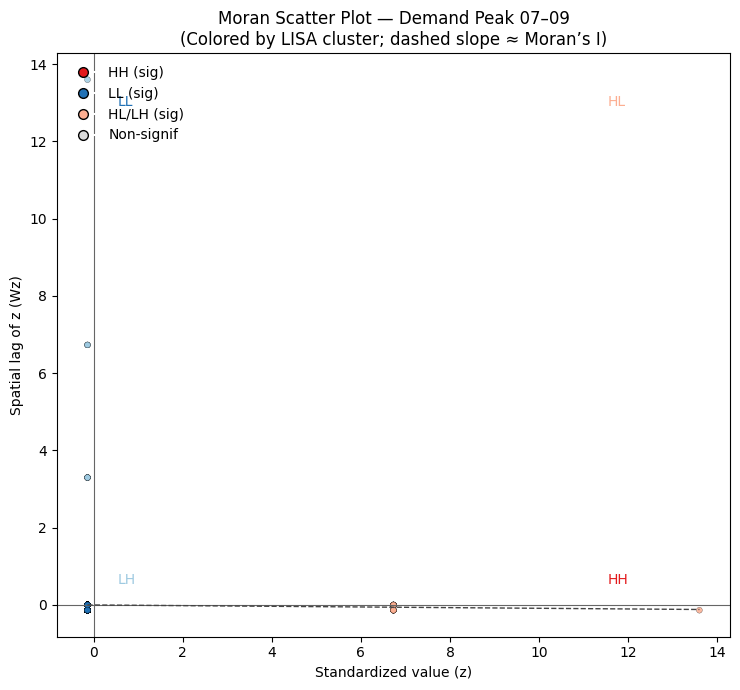

In [51]:
# ============================
# Moran Scatter Plot (ESDA)
# ============================
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from libpysal.weights import contiguity
from libpysal.weights.spatial_lag import lag_spatial
from esda import Moran, Moran_Local

# ---- 0) Siapkan data ESDA jika belum ada (pakai demand peak polygons gh_peak_nz) ----
need_build = False
for v in ["g","W","y","li"]:
    if v not in globals():
        need_build = True
        break

if need_build:
    # pastikan gh_peak_nz sudah ada (geohash cells peak 07–09 dengan total_count)
    g = gh_peak_nz.copy().rename(columns={"total_count":"weight"})
    g = g[g["weight"] > 0].copy().set_crs(4326)

    W = contiguity.Queen.from_dataframe(g)
    W.transform = "r"

    y = g["weight"].values.astype(float)
    mi = Moran(y, W)
    li = Moran_Local(y, W)
    g["lisa_q"]  = li.q
    g["lisa_p"]  = li.p_sim
    g["lisa_sig"]= g["lisa_p"] < 0.05

# ---- 1) Hitung z-score & spatial lag ----
z  = (y - y.mean()) / y.std(ddof=1)
wz = lag_spatial(W, z)

# ---- 2) Siapkan warna & label berdasarkan kuadran LISA ----
# 1=HH,2=LH,3=LL,4=HL (konvensi esda)
quad_color = {
    1: "#e31a1c",   # HH - merah
    2: "#9ecae1",   # LH - biru muda
    3: "#2171b5",   # LL - biru
    4: "#fcae91",   # HL - pink/oranye muda
}
colors = []
labels = []
for q, sig in zip(g["lisa_q"].values, g["lisa_sig"].values):
    if sig:
        colors.append(quad_color.get(q, "#999999"))
    else:
        colors.append("#d9d9d9")  # non-signif: abu

# ---- 3) Plot scatter ----
plt.figure(figsize=(7.5, 7.0))
plt.scatter(z, wz, s=18, c=colors, edgecolor="k", linewidth=0.2, alpha=0.85)

# crosshair di (0,0)
plt.axhline(0, color="#666", lw=0.8)
plt.axvline(0, color="#666", lw=0.8)

# garis regresi (Wz = a + b*z), b seharusnya ~ Moran's I
b = np.polyfit(z, wz, 1)[0]
xline = np.linspace(z.min(), z.max(), 100)
plt.plot(xline, b * xline, color="#444", lw=1.0, linestyle="--", label=f"Slope ≈ Moran's I ({b:.3f})")

# anotasi kuadran
pad = 0.05 * (xline.max() - xline.min())
plt.text(z.min()+pad, wz.max()-pad, "LL", fontsize=10, color="#2171b5")
plt.text(z.max()-3*pad, wz.max()-pad, "HL", fontsize=10, color="#fcae91")
plt.text(z.min()+pad, wz.min()+pad, "LH", fontsize=10, color="#9ecae1")
plt.text(z.max()-3*pad, wz.min()+pad, "HH", fontsize=10, color="#e31a1c")

# legend kecil untuk signifikan vs tidak
from matplotlib.lines import Line2D
legend_handles = [
    Line2D([0],[0], marker='o', color='w', label='HH (sig)', markerfacecolor=quad_color[1], markeredgecolor='k', markersize=7),
    Line2D([0],[0], marker='o', color='w', label='LL (sig)', markerfacecolor=quad_color[3], markeredgecolor='k', markersize=7),
    Line2D([0],[0], marker='o', color='w', label='HL/LH (sig)', markerfacecolor="#fcae91", markeredgecolor='k', markersize=7),
    Line2D([0],[0], marker='o', color='w', label='Non-signif', markerfacecolor="#d9d9d9", markeredgecolor='k', markersize=7),
]
plt.legend(handles=legend_handles, loc="upper left", frameon=False)

plt.xlabel("Standardized value (z)")
plt.ylabel("Spatial lag of z (Wz)")
plt.title("Moran Scatter Plot — Demand Peak 07–09\n(Colored by LISA cluster; dashed slope ≈ Moran’s I)")
plt.tight_layout()
plt.show()


In [52]:
# =========================================================
# ECONOMIC AGGREGATION PER KELURAHAN + CHOROPLETH + SAVE
# =========================================================
import numpy as np, pandas as pd, geopandas as gpd
import folium, time
from pathlib import Path
from folium.features import GeoJsonTooltip
from branca.colormap import LinearColormap

# ---------- 1) Siapkan metrik trip level ----------
df = df_avg_trip.copy()

# bersihkan nilai anomali dasar
df["distance_km"] = pd.to_numeric(df["distance_km"], errors="coerce")
df["duration_minutes"] = pd.to_numeric(df["duration_minutes"], errors="coerce")
df["fare_amount"] = pd.to_numeric(df["fare_amount"], errors="coerce")
df["surge_multiplier"] = pd.to_numeric(df["surge_multiplier"], errors="coerce")

# hindari div 0
dist = df["distance_km"].replace({0: np.nan})
df["fare_per_km"] = df["fare_amount"] / dist
df["duration_per_km"] = df["duration_minutes"] / dist

# optional winsorize ringan (clipping persentil) agar choropleth stabil
def winsorize(s, lo=0.01, hi=0.99):
    s1 = s.copy()
    qlo, qhi = s1.quantile(lo), s1.quantile(hi)
    return s1.clip(lower=qlo, upper=qhi)

df["fare_per_km_w"] = winsorize(df["fare_per_km"].replace([np.inf,-np.inf], np.nan))
df["duration_per_km_w"] = winsorize(df["duration_per_km"].replace([np.inf,-np.inf], np.nan))
df["surge_multiplier_w"] = winsorize(df["surge_multiplier"])

# ---------- 2) Agregasi per kelurahan (berdasar pickup_admin) ----------
grp = (df.groupby("pickup_admin")
         .agg(
             pickup_count=("pickup_admin","size"),
             avg_fare_per_km=("fare_per_km_w","mean"),
             median_fare_per_km=("fare_per_km_w","median"),
             avg_duration_per_km=("duration_per_km_w","mean"),
             median_duration_per_km=("duration_per_km_w","median"),
             avg_surge=("surge_multiplier_w","mean"),
             median_surge=("surge_multiplier_w","median"),
             avg_distance_km=("distance_km","mean"),
             avg_duration_min=("duration_minutes","mean"),
         )
         .reset_index()
      )

grp.rename(columns={"pickup_admin":"NAME_4"}, inplace=True)

# ---------- 3) Join ke boundaries (Admin4) ----------
econ = gdf_admin.merge(grp, on="NAME_4", how="left")

# isi NaN dengan 0 utk count, dan NaN untuk metrik rata-rata → biarkan agar tooltip tampil jelas
econ["pickup_count"] = econ["pickup_count"].fillna(0).astype(int)

# ---------- 4) Utility choropleth ----------
def add_choro(m, gdf, value_col, name, hi_red=True, tooltip_extra=()):
    """
    hi_red=True -> hijau (rendah) -> merah (tinggi)
    """
    v = gdf[value_col].dropna()
    vmin, vmax = float(v.min()) if len(v) else 0.0, float(v.max()) if len(v) else 1.0
    if vmax == vmin: vmax = vmin + (1.0 if vmax == 0 else abs(vmax)*0.05)
    colors = ["green","yellow","red"] if hi_red else ["red","yellow","green"]
    cmap = LinearColormap(colors, vmin=vmin, vmax=vmax); cmap.caption = f"{name}"
    folium.GeoJson(
        data=gdf.to_json(),
        name=name,
        style_function=lambda f: {
            "fillColor": cmap(f["properties"].get(value_col, 0) if f["properties"].get(value_col, None) is not None else vmin),
            "color": "#555","weight": 0.4,"fillOpacity": 0.75
        },
        tooltip=GeoJsonTooltip(
            fields=[c for c in ["NAME_4","pickup_count", value_col, *tooltip_extra] if c in gdf.columns],
            aliases=["Kelurahan","Pickup","Nilai", *[t.replace("_"," ").title() for t in tooltip_extra]],
            sticky=True, localize=True
        )
    ).add_to(m)
    cmap.add_to(m)

# ---------- 5) Peta: 3 layer (fare/km, surge, duration/km) ----------
m = folium.Map(location=[-6.2,106.8], zoom_start=11, tiles="CartoDB positron")

# Fare per km (merah = mahal)
add_choro(
    m, econ, "avg_fare_per_km",
    name="Avg Fare per km (Pickup)",
    hi_red=True,
    tooltip_extra=("median_fare_per_km","avg_distance_km")
)

# Surge (merah = tinggi)
add_choro(
    m, econ, "avg_surge",
    name="Avg Surge Multiplier",
    hi_red=True,
    tooltip_extra=("median_surge",)
)

# Duration per km (merah = lambat)
add_choro(
    m, econ, "avg_duration_per_km",
    name="Avg Duration per km (min/km)",
    hi_red=True,
    tooltip_extra=("median_duration_per_km","avg_duration_min")
)

folium.LayerControl(collapsed=False).add_to(m)
m

# ---------- 6) Simpan artefak ----------
ts = time.strftime("%Y%m%d-%H%M%S")
outdir = Path("data_artifacts") / ts
outdir.mkdir(parents=True, exist_ok=True)

econ_path_gj = outdir / "economics_admin4.geojson"
econ_path_csv = outdir / "economics_admin4.csv"

econ.to_file(econ_path_gj.as_posix(), driver="GeoJSON")
(econ.drop(columns="geometry")
     .to_csv(econ_path_csv, index=False))

print("[SAVED ECON ARTIFACTS]")
print(" ├─", econ_path_gj)
print(" └─", econ_path_csv)


[SAVED ECON ARTIFACTS]
 ├─ data_artifacts\20250920-122919\economics_admin4.geojson
 └─ data_artifacts\20250920-122919\economics_admin4.csv


In [53]:
# =========================================================
# PRIORITIZATION: HH (LISA) + Economics → Priority Kelurahan
# =========================================================
import numpy as np, pandas as pd, geopandas as gpd, folium, time
from pathlib import Path
from folium.features import GeoJsonTooltip
from branca.colormap import LinearColormap
from libpysal.weights import contiguity
from esda import Moran_Local

# ---------- 0) Pastikan LISA (HH/LL/HL/LH) di geohash peak ----------
g = gh_peak_nz.copy().rename(columns={"total_count":"weight"}).set_crs(4326)
W = contiguity.Queen.from_dataframe(g); W.transform = "r"
li = Moran_Local(g["weight"].values.astype(float), W)
g["lisa_q"]  = li.q                 # 1=HH,2=LH,3=LL,4=HL
g["lisa_p"]  = li.p_sim
g["lisa_sig"]= g["lisa_p"] < 0.05

# fokus HH signifikan
g_hh = g[(g["lisa_q"] == 1) & (g["lisa_sig"])].copy()

# ---------- 1) Agregasi HH geohash → Kelurahan ----------
# spatial join: geohash HH masuk kelurahan mana
hh_join = gpd.sjoin(g_hh, gdf_admin[["NAME_4","geometry"]], how="left", predicate="intersects")

hh_admin = (hh_join.groupby("NAME_4")
            .agg(hh_cells=("geohash_list","nunique"),
                 hh_weight=("weight","sum"))
            .reset_index())

# total geohash peak per kelurahan (denominator untuk proporsi)
all_join = gpd.sjoin(g, gdf_admin[["NAME_4","geometry"]], how="left", predicate="intersects")
all_admin = (all_join.groupby("NAME_4")
             .agg(total_cells=("geohash_list","nunique"),
                  total_weight=("weight","sum"))
             .reset_index())

hotspot_admin = (all_admin.merge(hh_admin, on="NAME_4", how="left")
                           .fillna({"hh_cells":0,"hh_weight":0}))

hotspot_admin["hh_cells_pct"]   = hotspot_admin["hh_cells"] / hotspot_admin["total_cells"].replace({0:np.nan})
hotspot_admin["hh_weight_share"]= hotspot_admin["hh_weight"] / hotspot_admin["total_weight"].replace({0:np.nan})
hotspot_admin = hotspot_admin.replace([np.inf,-np.inf], np.nan).fillna(0)

# ---------- 2) Join dengan metrik ekonomi per kelurahan ----------
# econ: hasil agregasi sebelumnya (avg_fare_per_km, avg_surge, dst)
prio = gdf_admin.merge(hotspot_admin, on="NAME_4", how="left") \
                .merge(econ.drop(columns="geometry"), on="NAME_4", how="left")

for c in ["hh_cells","hh_cells_pct","hh_weight","hh_weight_share","avg_fare_per_km","avg_surge"]:
    if c in prio.columns:
        prio[c] = prio[c].fillna(0)

# ---------- 3) Skor prioritas sederhana (z-score sum) ----------
def z(s): 
    s = s.astype(float)
    if s.std(ddof=0) == 0: 
        return pd.Series(np.zeros(len(s)), index=s.index)
    return (s - s.mean()) / s.std(ddof=0)

# komponen: intensitas hotspot (share), tarif per km (revenue proxy), surge (shortage proxy)
prio["z_hotspot"] = z(prio["hh_weight_share"])
prio["z_farekm"]  = z(prio["avg_fare_per_km"])
prio["z_surge"]   = z(prio["avg_surge"])

# kamu bisa ganti bobot jika perlu, mis: 0.5 hotspot + 0.3 surge + 0.2 fare
prio["priority_score"] = (prio["z_hotspot"] + prio["z_surge"] + prio["z_farekm"]) / 3.0

# ---------- 4) Tabel TOP-15 Kelurahan Prioritas ----------
cols_show = ["NAME_4","priority_score","hh_cells","hh_cells_pct","hh_weight_share",
             "avg_surge","avg_fare_per_km","pickup_count"]
top15 = (prio.drop(columns="geometry")
             .sort_values("priority_score", ascending=False)
             .head(15)
             .reset_index(drop=True)[cols_show])
display(top15)

# ---------- 5) Choropleth Priority Score ----------
m = folium.Map(location=[-6.2,106.8], zoom_start=11, tiles="CartoDB positron")
v = prio["priority_score"].fillna(0)
vmin, vmax = float(v.min()), float(v.max())
if vmax == vmin: vmax = vmin + 1e-6
cmap = LinearColormap(["#2ecc71","#f1c40f","#e74c3c"], vmin=vmin, vmax=vmax)  # hijau→kuning→merah

folium.GeoJson(
    prio.to_json(),
    name="Priority Score (HH + Surge + Fare/km)",
    style_function=lambda f: {
        "fillColor": cmap(f["properties"].get("priority_score", 0.0)),
        "color":"#444","weight":0.5,"fillOpacity":0.75
    },
    tooltip=GeoJsonTooltip(
        fields=["NAME_4","priority_score","hh_weight_share","avg_surge","avg_fare_per_km","pickup_count"],
        aliases=["Kelurahan","Priority","HH Weight Share","Avg Surge","Avg Fare/km","Pickup"],
        sticky=True, localize=True
    )
).add_to(m)
cmap.caption = "Priority Score"
cmap.add_to(m)
folium.LayerControl(collapsed=False).add_to(m)
m

# ---------- 6) Save artifacts ----------
ts = time.strftime("%Y%m%d-%H%M%S")
outdir = Path("data_artifacts") / ts
outdir.mkdir(parents=True, exist_ok=True)

prio_path_gj = outdir / "priority_admin4.geojson"
prio_path_csv = outdir / "priority_admin4.csv"
top_path_csv  = outdir / "priority_top15.csv"

prio.to_file(prio_path_gj.as_posix(), driver="GeoJSON")
(prio.drop(columns="geometry").to_csv(prio_path_csv, index=False))
top15.to_csv(top_path_csv, index=False)

print("[SAVED PRIORITY ARTIFACTS]")
print(" ├─", prio_path_gj)
print(" ├─", prio_path_csv)
print(" └─", top_path_csv)


C:\Users\hardy\AppData\Local\Temp\ipykernel_22468\1631141689.py:13: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  W = contiguity.Queen.from_dataframe(g); W.transform = "r"
C:\Users\hardy\anaconda3\envs\rideenv\lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 876 disconnected components.
 There are 729 islands with ids: 0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 24, 25, 26, 28, 30, 32, 33, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 54, 56, 57, 58, 60, 61, 62, 63, 65, 66, 67, 68, 69, 70, 71, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 90, 92, 93, 94, 96, 97, 98, 99, 101, 102, 104, 105, 106, 108, 109, 110, 111, 112, 113, 114, 117, 119, 123, 124, 125, 126, 127, 128, 129, 130, 131, 133, 136, 137, 139, 140, 142, 143, 144, 146, 148, 151, 154, 156, 158, 159, 1

('WARNING: ', 0, ' is an island (no neighbors)')
('WARNING: ', 1, ' is an island (no neighbors)')
('WARNING: ', 2, ' is an island (no neighbors)')
('WARNING: ', 3, ' is an island (no neighbors)')
('WARNING: ', 4, ' is an island (no neighbors)')
('WARNING: ', 5, ' is an island (no neighbors)')
('WARNING: ', 6, ' is an island (no neighbors)')
('WARNING: ', 7, ' is an island (no neighbors)')
('WARNING: ', 10, ' is an island (no neighbors)')
('WARNING: ', 11, ' is an island (no neighbors)')
('WARNING: ', 12, ' is an island (no neighbors)')
('WARNING: ', 13, ' is an island (no neighbors)')
('WARNING: ', 14, ' is an island (no neighbors)')
('WARNING: ', 15, ' is an island (no neighbors)')
('WARNING: ', 16, ' is an island (no neighbors)')
('WARNING: ', 17, ' is an island (no neighbors)')
('WARNING: ', 19, ' is an island (no neighbors)')
('WARNING: ', 20, ' is an island (no neighbors)')
('WARNING: ', 21, ' is an island (no neighbors)')
('WARNING: ', 22, ' is an island (no neighbors)')
('WARNIN

,NAME_4,priority_score,hh_cells,hh_cells_pct,hh_weight_share,avg_surge,avg_fare_per_km,pickup_count
0,Jati Pulo,0.962676,0.0,0.0,0.0,1.595000,13538.076571,6
1,Kampung Melayu,0.847877,0.0,0.0,0.0,1.878889,11244.535315,9
2,Cipinang,0.813661,0.0,0.0,0.0,1.912500,10810.076259,8
3,Johar Baru,0.804052,0.0,0.0,0.0,1.993077,10340.574499,13
4,Kemanggisan,0.782520,0.0,0.0,0.0,1.663000,11782.863987,20
5,Utan Kayu Selatan,0.753986,0.0,0.0,0.0,1.782500,10973.738106,4
6,Kuningan Barat,0.747915,0.0,0.0,0.0,1.668750,11481.429775,8
7,Kebon Manggis,0.707482,0.0,0.0,0.0,1.987500,9605.010429,4
8,Pasar Minggu,0.642746,0.0,0.0,0.0,1.706250,10467.527816,16
9,Kemayoran,0.638576,0.0,0.0,0.0,1.882500,9573.634568,4


[SAVED PRIORITY ARTIFACTS]
 ├─ data_artifacts\20250920-123219\priority_admin4.geojson
 ├─ data_artifacts\20250920-123219\priority_admin4.csv
 └─ data_artifacts\20250920-123219\priority_top15.csv


In [54]:
# demand_peak: centroid geohash peak 07–09, dengan kolom 'weight'
print("Demand points:", len(demand_peak), "Total weight:", demand_peak['weight'].sum())

Demand points: 1066 Total weight: 1087


In [55]:
# A) Geohash centroids (non-zero demand cells)
cand_geo = demand_peak.copy()
cand_geo["candidate_type"] = "geohash_centroid"

# B) KMeans adaptif (sudah punya cand_km)
cand_km["candidate_type"] = "kmeans_peak"

# C) Hybrid
cand_hybrid = pd.concat([cand_geo, cand_km], ignore_index=True)


In [56]:
L_list = [5, 10, 15]
R_list = [200, 300, 500]

results = []

for label, cand in [("Geohash", cand_geo), ("KMeans", cand_km), ("Hybrid", cand_hybrid)]:
    report = sweep_mclp_scenarios(
        demand_gdf=demand_peak,
        candidates_gdf=cand,
        L_list=L_list,
        R_list=R_list,
        weight_col="weight",
        out_dir="data_artifacts",
        save_geojson=False,
        solver_msg=False
    )
    report["candidate_type"] = label
    results.append(report)

report_all = pd.concat(results, ignore_index=True)
report_all.sort_values(["candidate_type","R_meter","L"], inplace=True)
display(report_all)


,L,R_meter,selected_count,covered_weight,total_weight,coverage_pct,candidate_type
0,5,200,5,17.0,1087.0,0.015639,Geohash
1,10,200,10,32.0,1087.0,0.029439,Geohash
2,15,200,15,47.0,1087.0,0.043238,Geohash
3,5,300,5,20.0,1087.0,0.018399,Geohash
4,10,300,10,39.0,1087.0,0.035879,Geohash
5,15,300,15,54.0,1087.0,0.049678,Geohash
6,5,500,5,38.0,1087.0,0.034959,Geohash
7,10,500,10,71.0,1087.0,0.065317,Geohash
8,15,500,15,101.0,1087.0,0.092916,Geohash
18,5,200,5,17.0,1087.0,0.015639,Hybrid


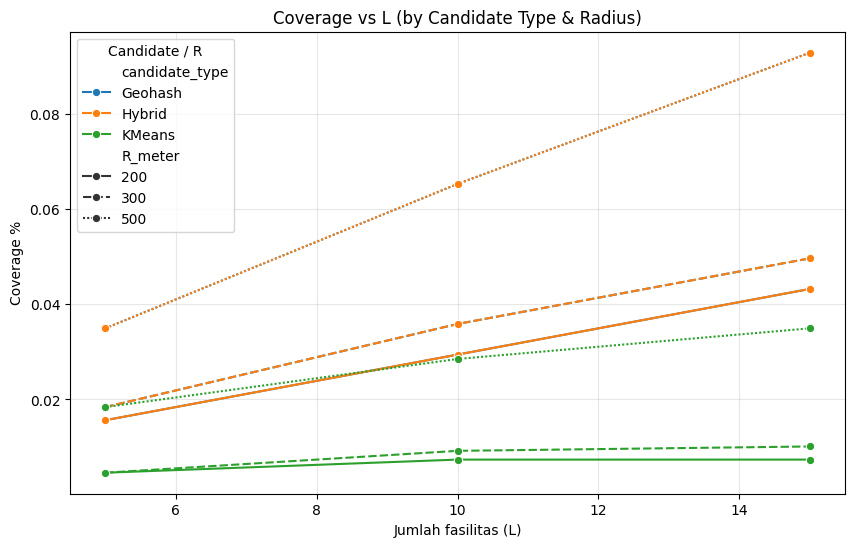

In [57]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.lineplot(
    data=report_all,
    x="L", y="coverage_pct", hue="candidate_type", style="R_meter", marker="o"
)
plt.title("Coverage vs L (by Candidate Type & Radius)")
plt.ylabel("Coverage %")
plt.xlabel("Jumlah fasilitas (L)")
plt.grid(True, alpha=0.3)
plt.legend(title="Candidate / R")
plt.show()


In [58]:
import time
from pathlib import Path

ts = time.strftime("%Y%m%d-%H%M%S")
outdir = Path("data_artifacts") / f"week4_scenarios_{ts}"
outdir.mkdir(parents=True, exist_ok=True)

out_csv = outdir / "mclp_multi_scenarios.csv"
report_all.to_csv(out_csv, index=False)

print("[SAVED] Multi-scenario MCLP results →", out_csv)


[SAVED] Multi-scenario MCLP results → data_artifacts\week4_scenarios_20250920-123422\mclp_multi_scenarios.csv
